In [1]:
%load_ext autoreload
%autoreload 2

import pymc as pm
import seaborn as sns
import pandas as pd
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import numpy as np
import arviz as az
from matplotlib import pyplot as plt

import sys
sys.path.append('..')
from pfas_prep import PFAS
from PyPKMC import PyPKMC
import register_pfas_data as rpd

In [2]:
chemical = 'PFBS'
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, skip_hero=[2850396])#, hero_only=1289834) # 
Vdss_prior = {'mu': -1.5, 'sd': 1.5}
CLC_prior = {'mu': -2.89, 'sd': 2.68}
load_trace = False

# Rat fits

## Male

First import the data using the old PFAS class

In [3]:
%%time
pfas_male_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='rat')
pfas_male_data.head()

Hero ID available:  [1326734 2850396 5387170 6579272]
dropping duplicated column
Hero ID used:  [1326734 2850396 5387170]
CPU times: user 714 ms, sys: 7 ms, total: 721 ms
Wall time: 722 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1326734,28,1,1,-1.0,NaN,0.296437,NaN,rat,sprague-dawley,30.0,mg/kg,0.25,hour,109.374868,0.0,0,ug/ml,iv,serum,Male,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.010417,30.0,63.010417,0.296437,109.374868,0.0,0.0,-1,0,0,0,0.0,4.694781,0.0,True,8.893107,1326734-30.0 mg/kg-iv
1,1326734,28,2,1,-1.0,NaN,0.296437,NaN,rat,sprague-dawley,30.0,mg/kg,0.25,hour,129.859934,0.0,0,ug/ml,iv,serum,Male,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.010417,30.0,63.010417,0.296437,129.859934,0.0,0.0,-1,0,0,0,0.0,4.866456,0.0,True,8.893107,1326734-30.0 mg/kg-iv
2,1326734,28,3,1,-1.0,NaN,0.296437,NaN,rat,sprague-dawley,30.0,mg/kg,0.25,hour,129.859934,0.0,0,ug/ml,iv,serum,Male,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.010417,30.0,63.010417,0.296437,129.859934,0.0,0.0,-1,0,0,0,0.0,4.866456,0.0,True,8.893107,1326734-30.0 mg/kg-iv
3,1326734,28,1,1,-1.0,NaN,0.296437,NaN,rat,sprague-dawley,30.0,mg/kg,0.50,hour,72.572530,0.0,0,ug/ml,iv,serum,Male,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.020833,30.0,63.020833,0.296474,72.572530,0.0,0.0,-1,0,0,0,0.0,4.284586,0.0,True,8.893107,1326734-30.0 mg/kg-iv
4,1326734,28,2,1,-1.0,NaN,0.296437,NaN,rat,sprague-dawley,30.0,mg/kg,0.50,hour,114.890386,0.0,0,ug/ml,iv,serum,Male,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.020833,30.0,63.020833,0.296474,114.890386,0.0,0.0,-1,0,0,0,0.0,4.743979,0.0,True,8.893107,1326734-30.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [4]:
pfas_male_1cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx', 
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt.sample(model_type='1-compartment', target_accept=0.999, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Male_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

2024-08-16 13:10:03.748293: E external/xla/xla/service/slow_operation_alarm.cc:65] Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,203]{2,1,0} reduce(f64[4,5000,1,203]{3,2,1,0} %broadcast.35, f64[] %constant.40), dimensions={2}, to_apply=%region_1.99, metadata={op_name="jit(process_fn)/jit(main)/reduce_prod[axes=(2,)]" source_file="/data/tzurlind/tmp/tmpyqy1y2jd" source_line=59}

This isn't necessarily a bug; constant-folding is inherently a trade-off between compilation time and speed at runtime. XLA has some guards that attempt to keep constant folding from taking too long, but fundamentally you'll always be able to come up with an input program that takes a long time.

If you'd like to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
2024-08-16 13:10:16.400199: E external/xla/xla/service/slow_operation_alarm.cc:133] The operation took 13.652031006s
Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,203]

Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


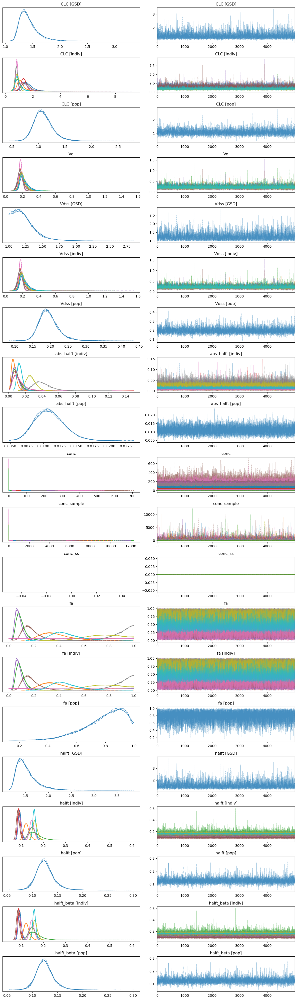

In [5]:
with pfas_male_1cmpt.model:
    az.plot_trace(pfas_male_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


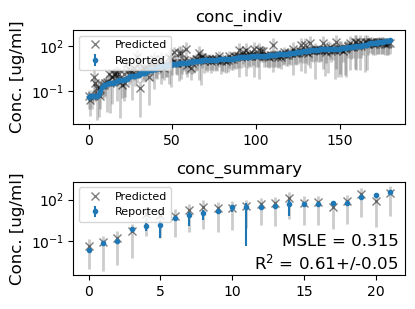

In [6]:
pfas_male_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [102]:
pfas_male_2cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx', Rkcd_SD_prior = 1,
                         CLC_prior = CLC_prior, 
                         Vdss_prior = Vdss_prior,
                         #Vdss_prior = {'mu': 0, 'sd':1.5}
                        )
pfas_male_2cmpt.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro', random_seed=12345,
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Male_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

2024-08-16 15:18:30.858965: E external/xla/xla/service/slow_operation_alarm.cc:65] Constant folding an instruction is taking > 16s:

  %reduce.100 = f64[4,5000,203]{2,1,0} reduce(f64[4,5000,1,203]{3,2,1,0} %broadcast.52, f64[] %constant.69), dimensions={2}, to_apply=%region_31.729, metadata={op_name="jit(process_fn)/jit(main)/reduce_prod[axes=(2,)]" source_file="/data/tzurlind/tmp/tmpwrsoy3bo" source_line=493}

This isn't necessarily a bug; constant-folding is inherently a trade-off between compilation time and speed at runtime. XLA has some guards that attempt to keep constant folding from taking too long, but fundamentally you'll always be able to come up with an input program that takes a long time.

If you'd like to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
2024-08-16 15:18:31.243482: E external/xla/xla/service/slow_operation_alarm.cc:133] The operation took 16.384644357s
Constant folding an instruction is taking > 16s:

  %reduce.100 = f6

Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


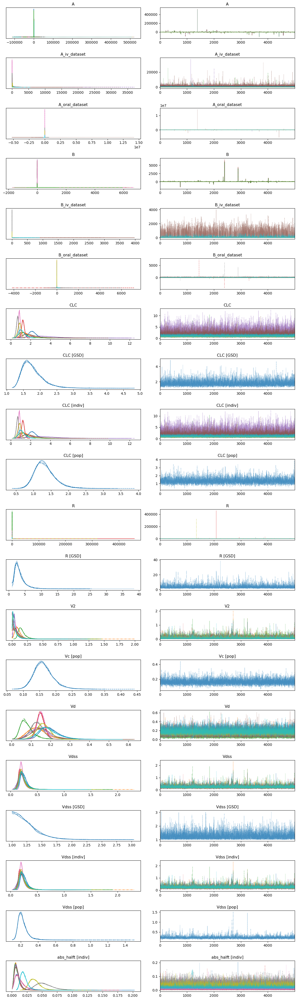

In [103]:
with pfas_male_2cmpt.model:
    az.plot_trace(pfas_male_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


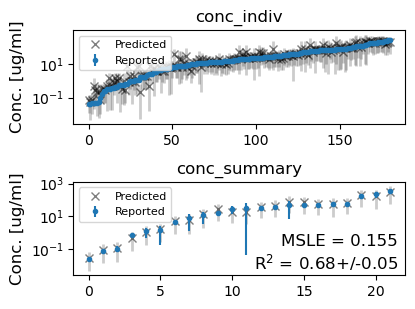

In [104]:
pfas_male_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-825.597899,56.141279,0.000000,0.941794,52.696983,0.000000,True,log
1_compartment,1,-879.615818,48.943401,54.017918,0.058206,55.491624,14.067048,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

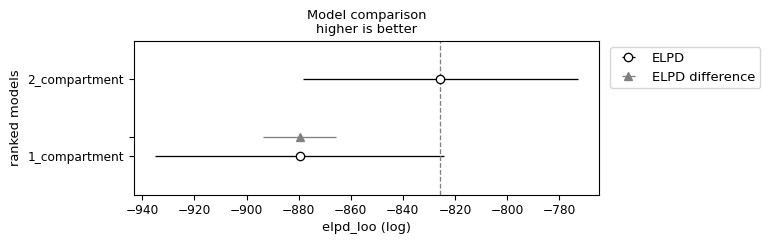

In [105]:
pfas_male_compare = az.compare({"1_compartment": pfas_male_1cmpt._trace, "2_compartment": pfas_male_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_male_compare)
az.plot_compare(pfas_male_compare, insample_dev=False)

#### Define winning model

In [106]:
pfas_male = pfas_male_2cmpt
print(pfas_male.N_divergences)
print(f'Pass all metrics = {pfas_male.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


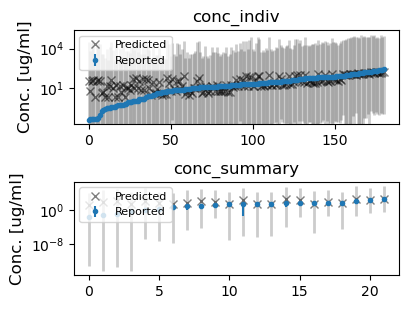

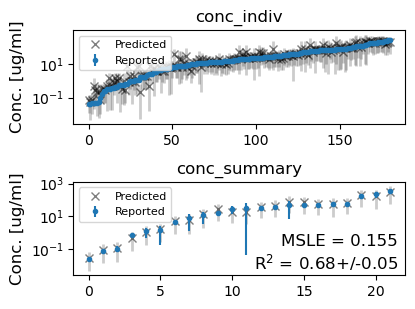

In [107]:
pfas_male.plot_data_ppc(group='prior', savefig=True)
pfas_male.plot_data_ppc(group='posterior', savefig=True)

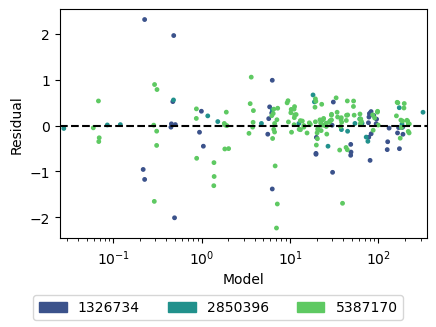

In [108]:
pfas_male.plot_residuals() 

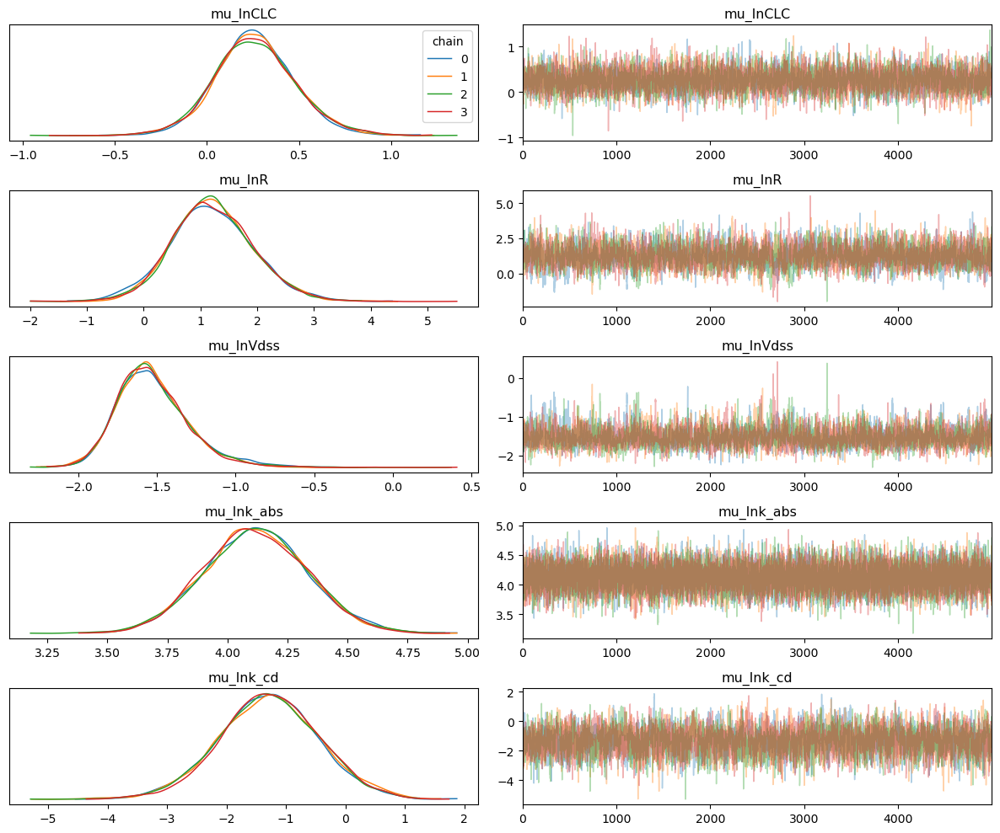

In [109]:
trace_model = pfas_male
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFBS/PFBS_Male_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


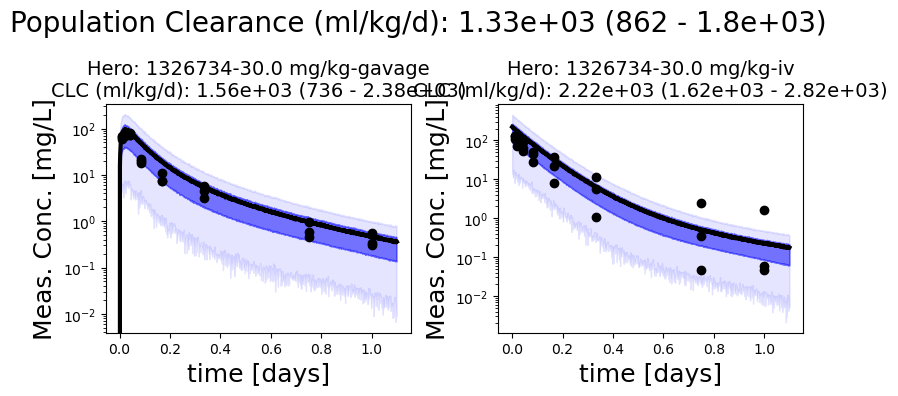

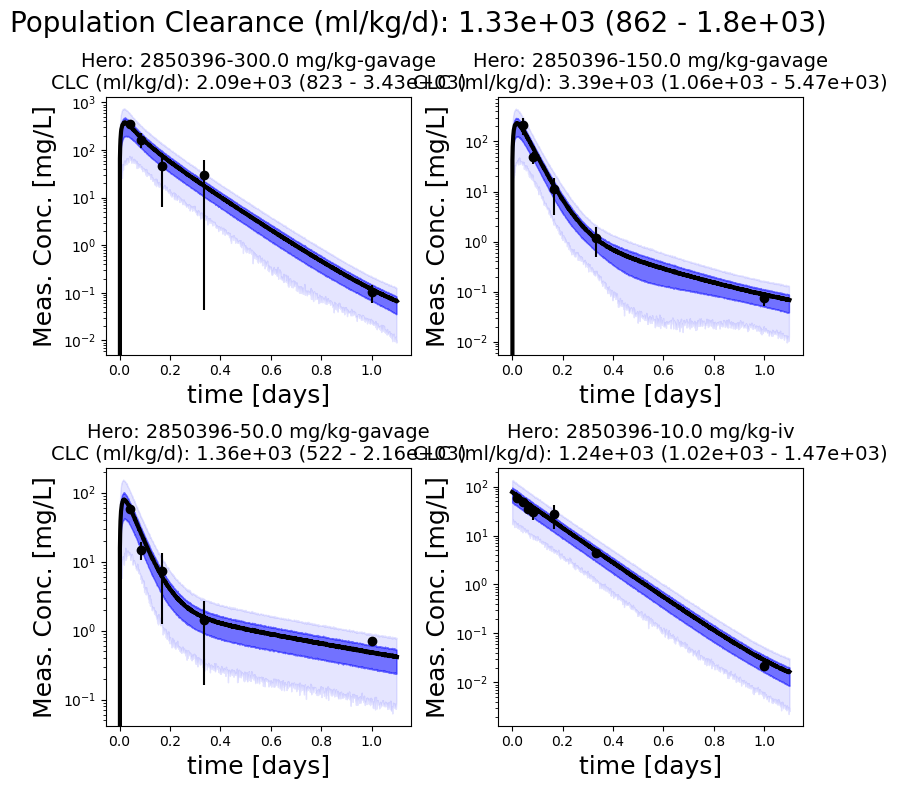

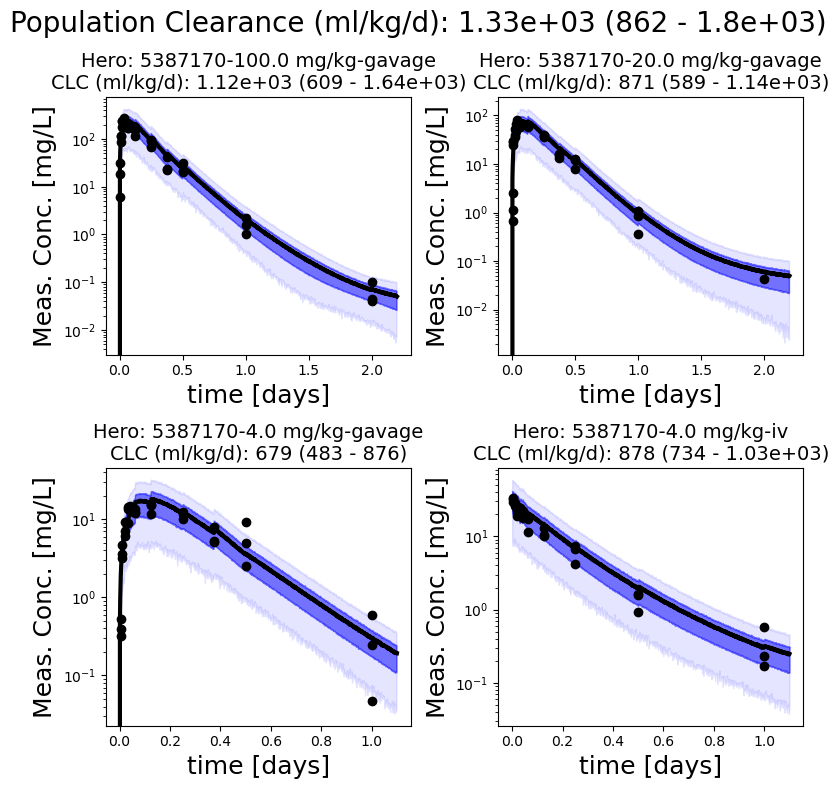

In [110]:
pfas_male.plot_all_studies()

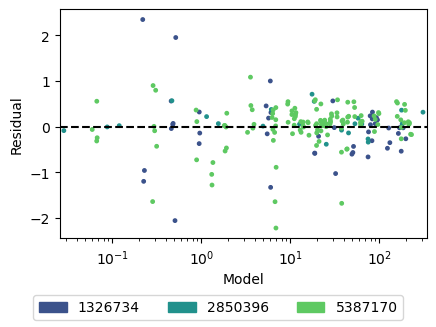

In [111]:
pfas_male.plot_residuals()

### PK stats

In [112]:
pfas_male.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],1.32950,0.30466,0.86202,1.79851
Vc [pop],0.16292,0.03073,0.11559,0.21137
Vdss [pop],0.22390,0.06192,0.14376,0.30145
abs_halft [pop],0.01154,0.00249,0.00751,0.01545
fa [pop],0.79531,0.13957,0.59347,0.99516
halft [pop],0.12048,0.03694,0.07071,0.16684
halft_alpha [pop],0.08166,0.02084,0.04945,0.11547
halft_beta [pop],1.41404,2.03168,0.06989,3.09787


## Female

In [18]:
%%time
pfas_female_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='rat')
pfas_female_data.head()

Hero ID available:  [1326734 2850396 5387170 6579272]
dropping duplicated column
Hero ID used:  [1326734 2850396 5387170]
CPU times: user 610 ms, sys: 3.2 ms, total: 614 ms
Wall time: 614 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1326734,29,4,1,-1.0,NaN,0.202216,NaN,rat,sprague-dawley,30.0,mg/kg,0.25,hour,89.208463,0.0,0,ug/ml,iv,serum,Female,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.010417,30.0,63.010417,0.202216,89.208463,0.0,0.0,-1,0,0,1,0.0,4.490976,0.0,True,6.066491,1326734-30.0 mg/kg-iv
1,1326734,29,5,1,-1.0,NaN,0.202216,NaN,rat,sprague-dawley,30.0,mg/kg,0.25,hour,74.004470,0.0,0,ug/ml,iv,serum,Female,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.010417,30.0,63.010417,0.202216,74.004470,0.0,0.0,-1,0,0,1,0.0,4.304125,0.0,True,6.066491,1326734-30.0 mg/kg-iv
2,1326734,29,4,1,-1.0,NaN,0.202216,NaN,rat,sprague-dawley,30.0,mg/kg,0.50,hour,48.273774,0.0,0,ug/ml,iv,serum,Female,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.020833,30.0,63.020833,0.202233,48.273774,0.0,0.0,-1,0,0,1,0.0,3.876888,0.0,True,6.066491,1326734-30.0 mg/kg-iv
3,1326734,29,5,1,-1.0,NaN,0.202216,NaN,rat,sprague-dawley,30.0,mg/kg,0.50,hour,41.870498,0.0,0,ug/ml,iv,serum,Female,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.020833,30.0,63.020833,0.202233,41.870498,0.0,0.0,-1,0,0,1,0.0,3.734581,0.0,True,6.066491,1326734-30.0 mg/kg-iv
4,1326734,29,4,1,-1.0,NaN,0.202216,NaN,rat,sprague-dawley,30.0,mg/kg,1.00,hour,18.833622,0.0,0,ug/ml,iv,serum,Female,DTXSID5030030,Figure 2,9.0,weeks,NaN,Not Reported,3,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,8,0,0,0,0.041667,30.0,63.041667,0.202265,18.833622,0.0,0.0,-1,0,0,1,0.0,2.935644,0.0,True,6.066491,1326734-30.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [19]:
pfas_female_1cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Female_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


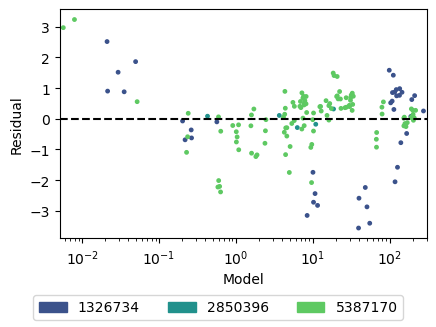

In [20]:
pfas_female_1cmpt.plot_residuals()

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


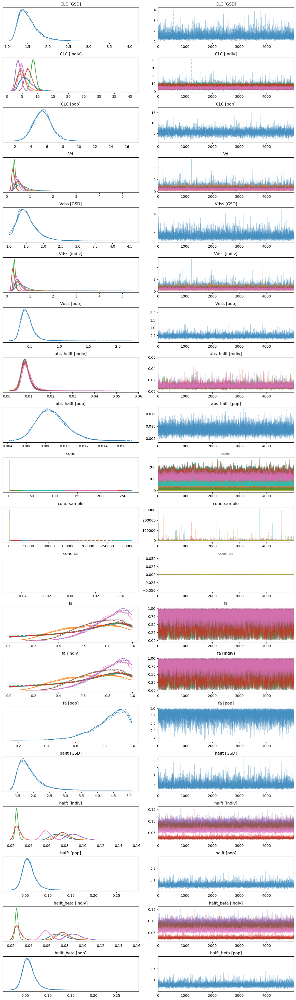

In [21]:
with pfas_female_1cmpt.model:
    az.plot_trace(pfas_female_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


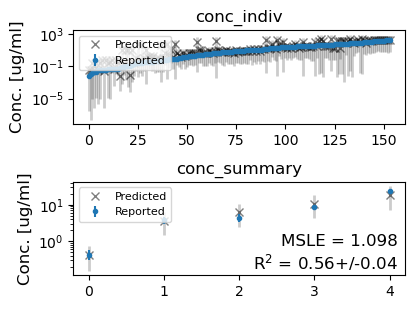

In [22]:
pfas_female_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [23]:
pfas_female_2cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   #load_trace=load_trace, tune=10000, draws=5000, likelihood='Normal', sample_prior=True, sample_posterior=True)
                         load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Female_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


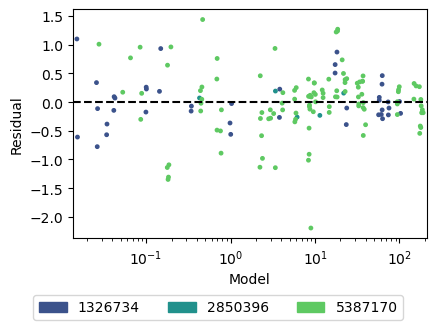

In [24]:
pfas_female_2cmpt.plot_residuals() # lognormal

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


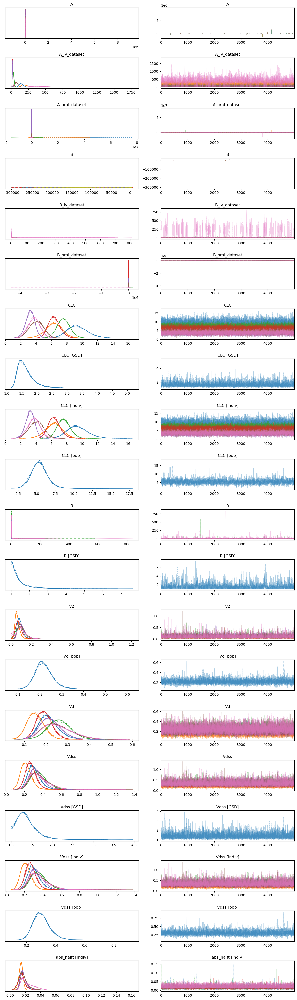

In [25]:
with pfas_female_2cmpt.model:
    az.plot_trace(pfas_female_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


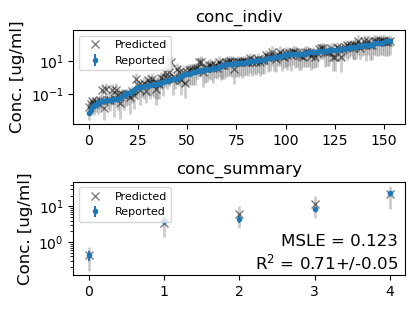

In [26]:
pfas_female_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-397.640951,30.450175,0.000000,0.969612,32.844713,0.000000,True,log
1_compartment,1,-497.187287,29.873441,99.546336,0.030388,32.107195,18.292514,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

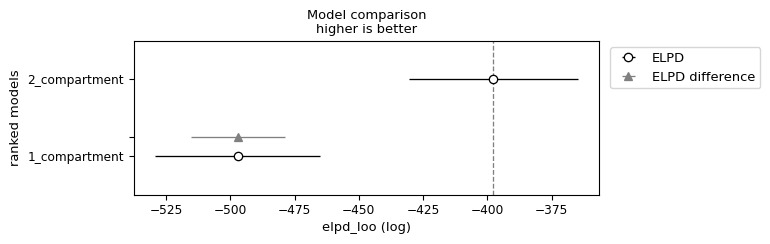

In [27]:
pfas_female_compare = az.compare({"1_compartment": pfas_female_1cmpt._trace, "2_compartment": pfas_female_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_female_compare)
az.plot_compare(pfas_female_compare, insample_dev=False)

#### Define winning model

In [97]:
pfas_female = pfas_female_2cmpt
print(pfas_female.N_divergences)
print(f'Pass all metrics = {pfas_female.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


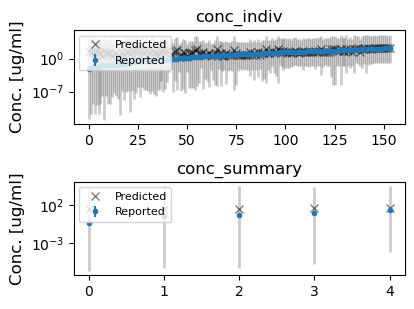

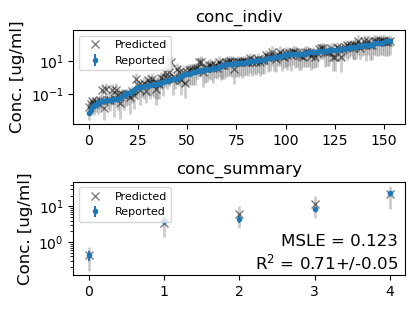

In [29]:
pfas_female.plot_data_ppc(group='prior', savefig=True)
pfas_female.plot_data_ppc(group='posterior', savefig=True)

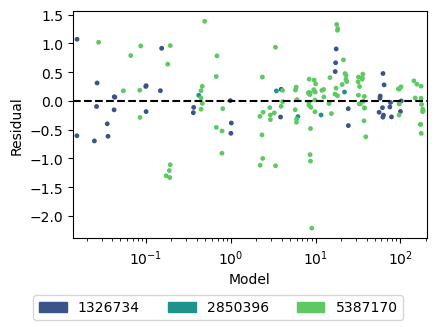

In [30]:
pfas_female.plot_residuals() 

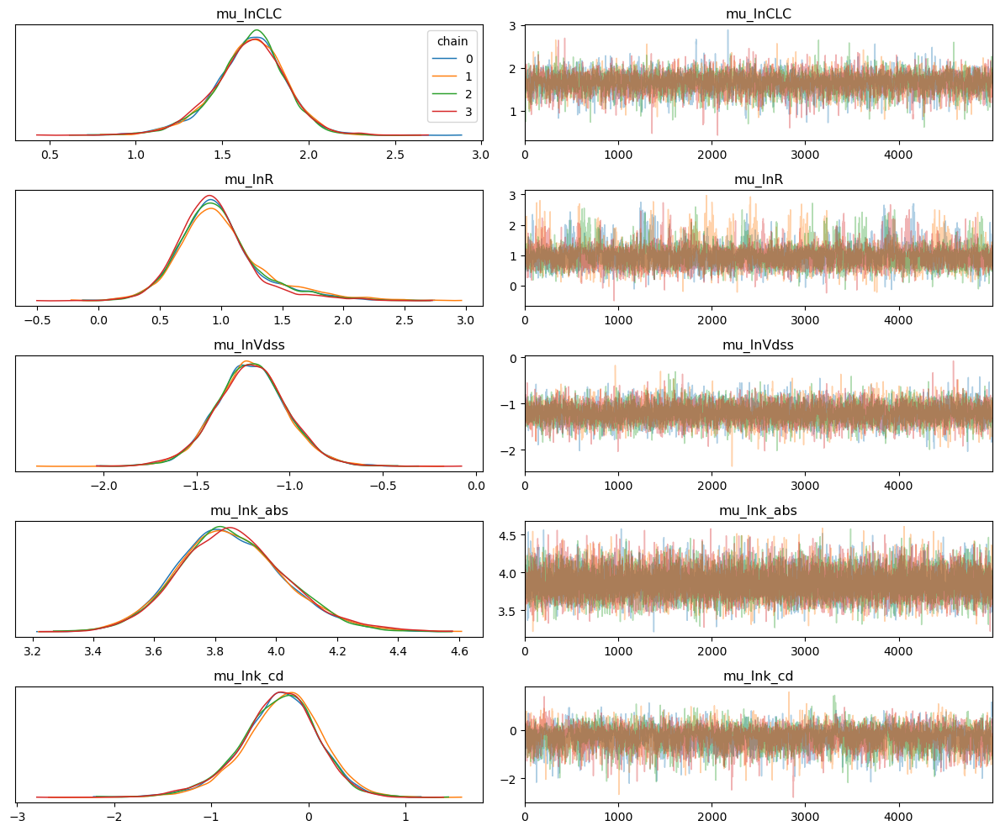

In [31]:
trace_model = pfas_female
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFBS/PFBS_Female_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


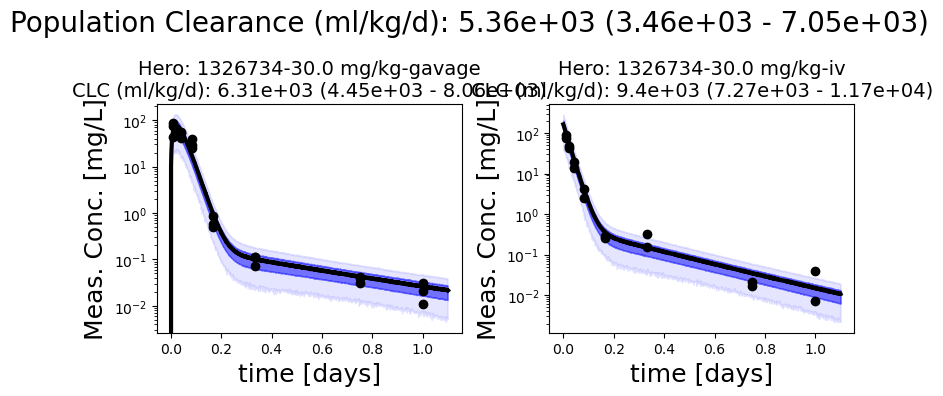

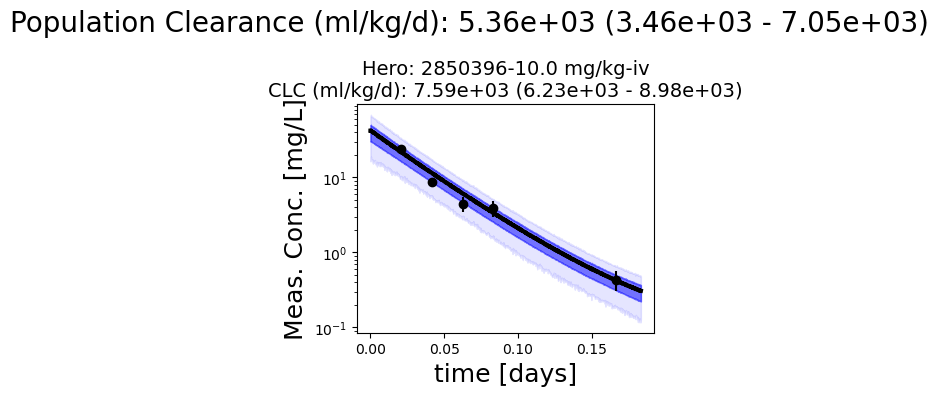

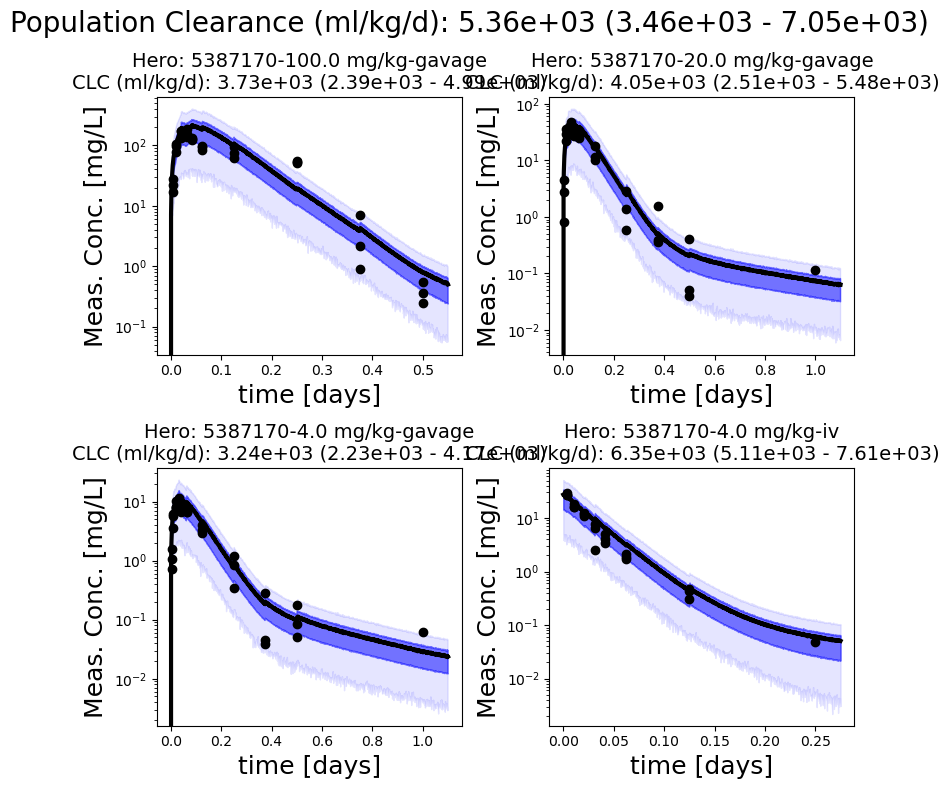

In [32]:
pfas_female.plot_all_studies()

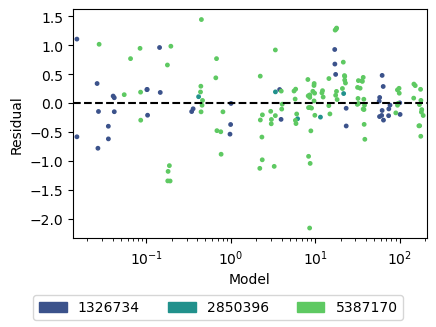

In [33]:
pfas_female.plot_residuals()

### PK stats

In [34]:
pfas_female.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],5.36134,1.13323,3.45669,7.04824
Vc [pop],0.21907,0.04201,0.14965,0.28153
Vdss [pop],0.30510,0.06104,0.21091,0.40078
abs_halft [pop],0.01490,0.00259,0.01051,0.01895
fa [pop],0.85404,0.11197,0.70141,0.99901
halft [pop],0.04090,0.01101,0.02420,0.05687
halft_alpha [pop],0.02821,0.00707,0.01739,0.03883
halft_beta [pop],0.41834,0.23464,0.07930,0.69271


# Mouse

## Male

In [35]:
%%time
pfas_male_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='mouse')
pfas_male_data_mouse.head()

Hero ID available:  [1326734 2850396 5387170 6579272]
dropping duplicated column
Hero ID used:  [6579272]
CPU times: user 81.1 ms, sys: 3.45 ms, total: 84.5 ms
Wall time: 84 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,6579272,43,15995,1,-1.0,NaN,0.031,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,29822.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,31.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.031,29.822,0.0,0.0,-1,0,1,0,0.0,3.395246,0.0,True,0.93,6579272-30.0 mg/kg-gavage
1,6579272,43,15996,1,-1.0,NaN,0.031,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,7238.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,31.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.031,7.238,0.0,0.0,-1,0,1,0,0.0,1.979345,0.0,True,0.93,6579272-30.0 mg/kg-gavage
2,6579272,43,15997,1,-1.0,NaN,0.031,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,63901.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,31.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.031,63.901,0.0,0.0,-1,0,1,0,0.0,4.157335,0.0,True,0.93,6579272-30.0 mg/kg-gavage
3,6579272,43,15998,1,-1.0,NaN,0.031,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,49877.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,31.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.031,49.877,0.0,0.0,-1,0,1,0,0.0,3.909560,0.0,True,0.93,6579272-30.0 mg/kg-gavage
4,6579272,43,15999,1,-1.0,NaN,0.031,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,209973.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,31.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.031,209.973,0.0,0.0,-1,0,1,0,0.0,5.346979,0.0,True,0.93,6579272-30.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [36]:
pfas_male_1cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Male_mouse_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


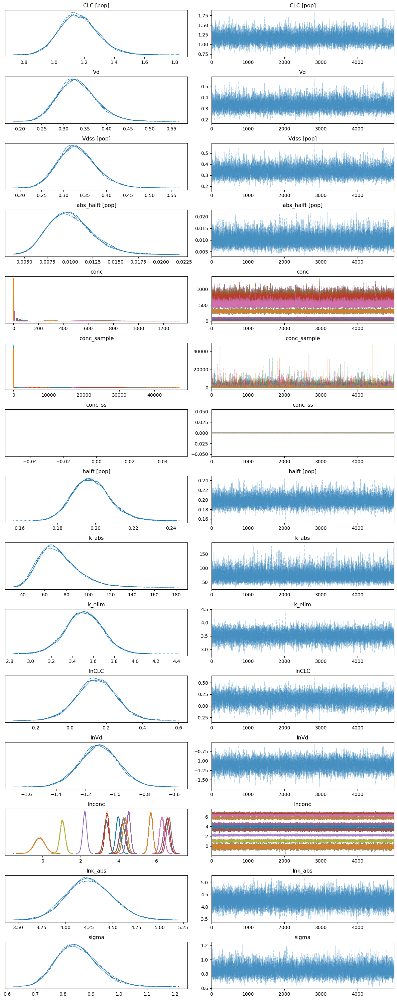

In [37]:
with pfas_male_1cmpt_mouse.model:
    az.plot_trace(pfas_male_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


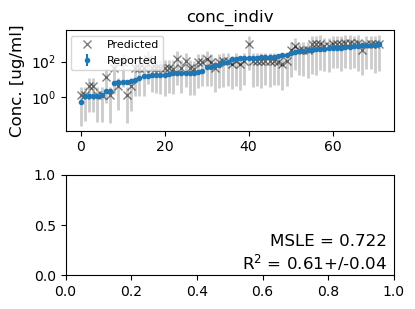

In [38]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [39]:
pfas_male_2cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro', #hierarchy='single',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Male_mouse_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


In [40]:
pfas_male_2cmpt_mouse.bayes_r2 # Single

r2        0.615533
r2_std    0.045035
dtype: float64

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


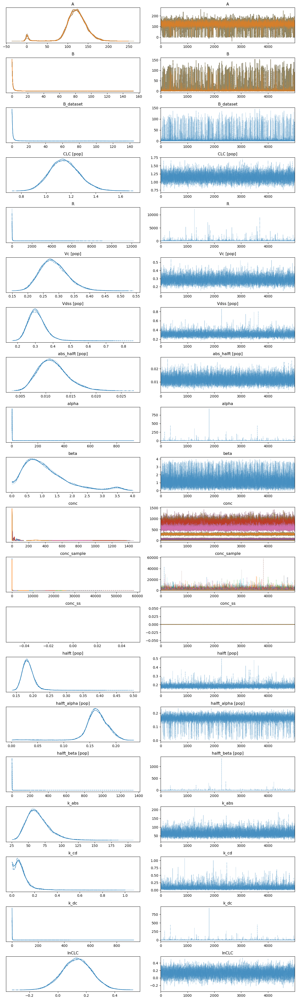

In [41]:
with pfas_male_2cmpt_mouse.model:
    az.plot_trace(pfas_male_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


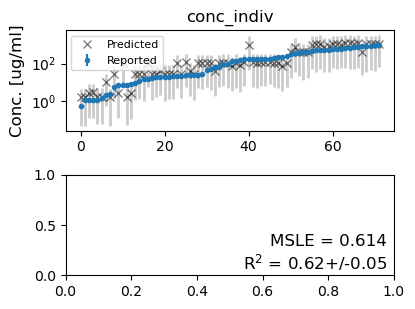

In [42]:
pfas_male_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-388.168834,5.060475,0.000000,1.0,16.573402,0.000000,False,log
1_compartment,1,-392.081741,3.479180,3.912906,0.0,16.277671,2.249675,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

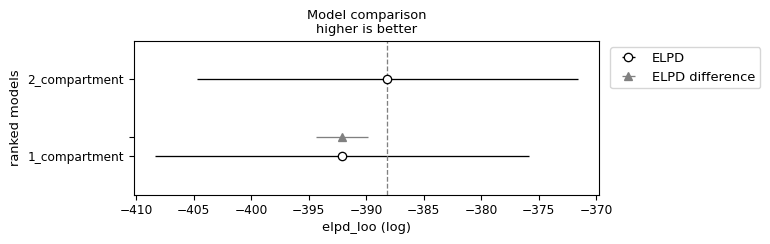

In [43]:
pfas_male_mouse_compare = az.compare({"1_compartment": pfas_male_1cmpt_mouse._trace, "2_compartment": pfas_male_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_male_mouse_compare)
az.plot_compare(pfas_male_mouse_compare, insample_dev=False)

#### Define winning model

In [98]:
pfas_male_mouse = pfas_male_2cmpt_mouse
pfas_male_mouse.N_divergences
print(f'Pass all metrics = {pfas_male_mouse.pass_all_metrics}')

Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


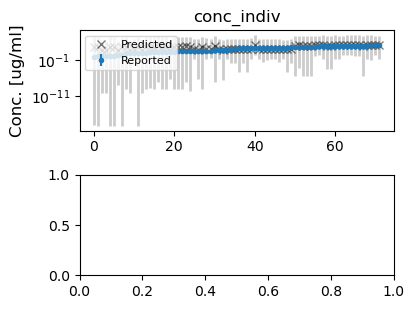

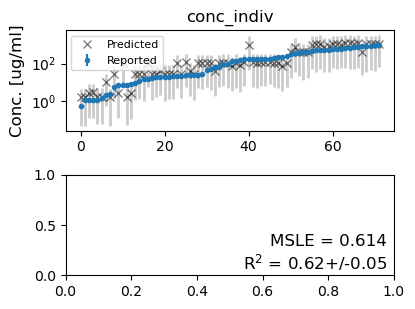

In [45]:
pfas_male_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_male_mouse.plot_data_ppc(group='posterior', savefig=True)

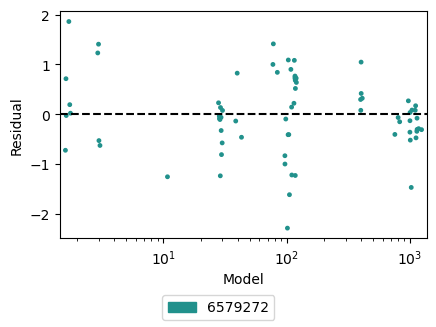

In [46]:
pfas_male_mouse.plot_residuals() 

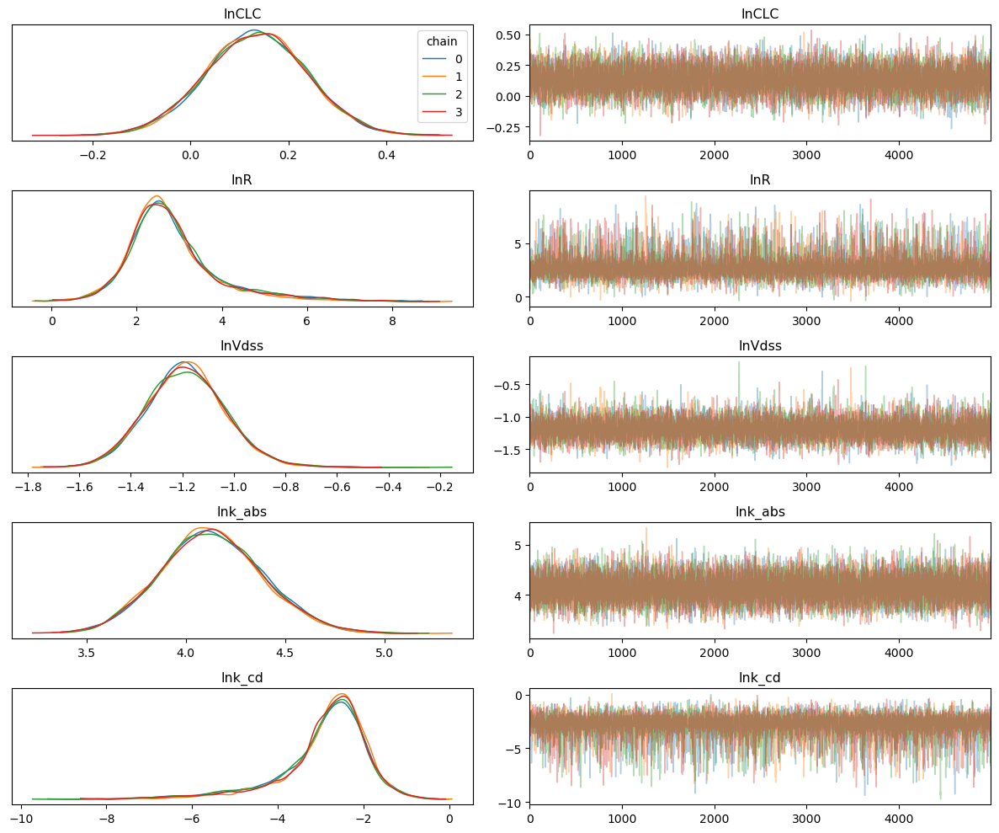

In [47]:
trace_model = pfas_male_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFBS/PFBS_Male_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


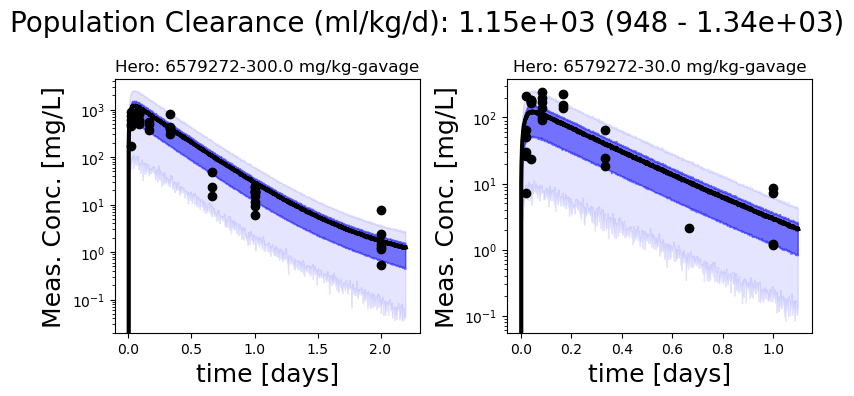

In [48]:
pfas_male_mouse.plot_all_studies()

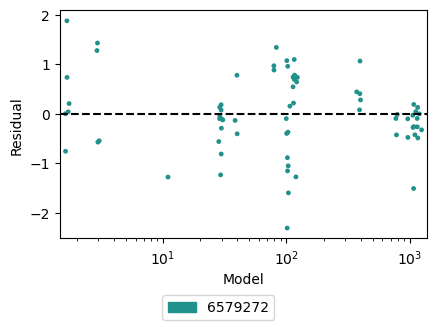

In [49]:
pfas_male_mouse.plot_residuals()

### PK stats

In [50]:
pfas_male_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],1.14951,0.11991,0.94838,1.33996
Vc [pop],0.28428,0.04438,0.21198,0.35427
Vdss [pop],0.30950,0.05022,0.23290,0.38572
abs_halft [pop],0.01149,0.00294,0.00662,0.01604
halft [pop],0.18624,0.01966,0.15840,0.21184
halft_alpha [pop],0.16292,0.02507,0.13791,0.20011
halft_beta [pop],1.54191,13.07210,0.17985,1.97609


## Female

In [51]:
%%time
pfas_female_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='mouse')
pfas_female_data_mouse.head()

Hero ID available:  [1326734 2850396 5387170 6579272]
dropping duplicated column
Hero ID used:  [6579272]
CPU times: user 80.5 ms, sys: 2.51 ms, total: 83 ms
Wall time: 82.4 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,6579272,44,15989,1,-1.0,NaN,0.029,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,42661.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,29.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.029,42.661,0.0,0.0,-1,0,1,1,0.0,3.753285,0.0,True,0.87,6579272-30.0 mg/kg-gavage
1,6579272,44,15990,1,-1.0,NaN,0.029,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,197731.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,29.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.029,197.731,0.0,0.0,-1,0,1,1,0.0,5.286908,0.0,True,0.87,6579272-30.0 mg/kg-gavage
2,6579272,44,15991,1,-1.0,NaN,0.029,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,8762.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,29.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.029,8.762,0.0,0.0,-1,0,1,1,0.0,2.170424,0.0,True,0.87,6579272-30.0 mg/kg-gavage
3,6579272,44,15992,1,-1.0,NaN,0.029,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,39455.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,29.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.029,39.455,0.0,0.0,-1,0,1,1,0.0,3.675161,0.0,True,0.87,6579272-30.0 mg/kg-gavage
4,6579272,44,15993,1,-1.0,NaN,0.029,NaN,mouse,CD1,30.0,mg/kg,0.5,hour,156866.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID5030030,PK-PFBS-all blocks (include urine).xlsx,10.0,weeks,29.0,grams,1,Lau,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.020833,30.0,0.029,156.866,0.0,0.0,-1,0,1,1,0.0,5.055392,0.0,True,0.87,6579272-30.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [52]:
pfas_female_1cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Female_mouse_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


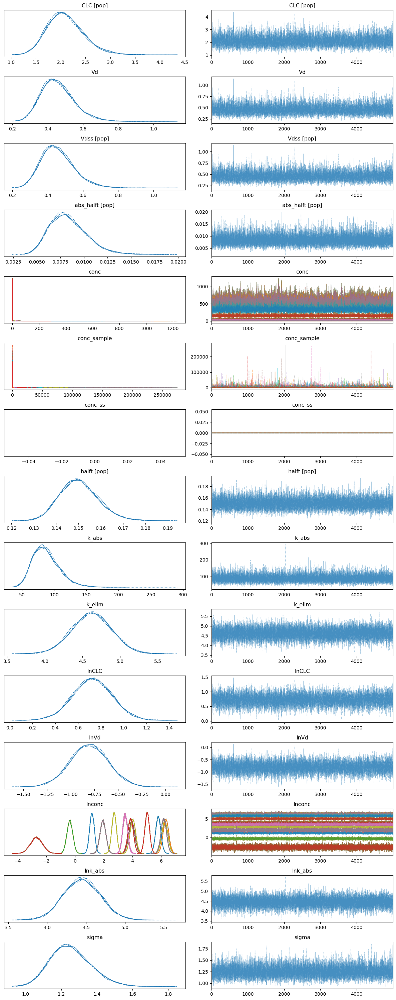

In [53]:
with pfas_female_1cmpt_mouse.model:
    az.plot_trace(pfas_female_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


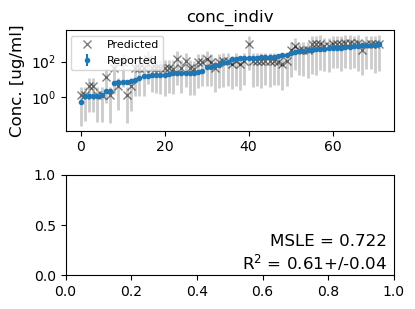

In [54]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [55]:
pfas_female_2cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Female_mouse_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


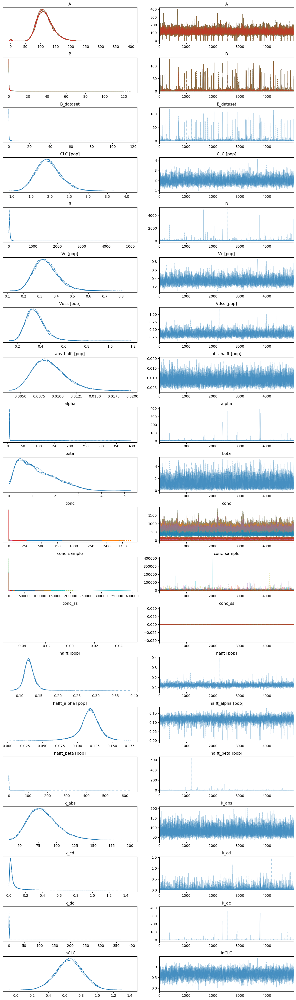

In [56]:
with pfas_female_2cmpt_mouse.model:
    az.plot_trace(pfas_female_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


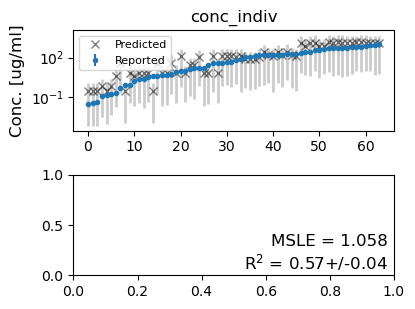

In [57]:
pfas_female_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-316.761220,6.467944,0.000000,0.898168,21.127513,0.000000,False,log
1_compartment,1,-321.242909,5.039747,4.481689,0.101832,21.334163,3.315525,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

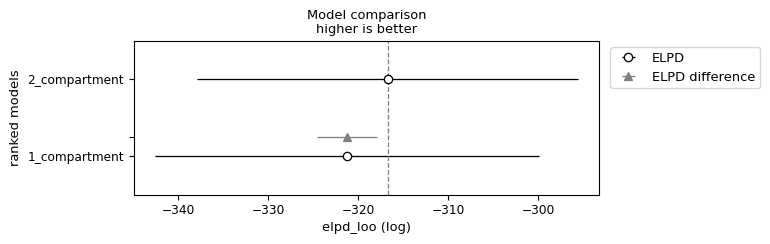

In [58]:
pfas_female_mouse_compare = az.compare({"1_compartment": pfas_female_1cmpt_mouse._trace, "2_compartment": pfas_female_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_female_mouse_compare)
az.plot_compare(pfas_female_mouse_compare, insample_dev=False)

#### Define winning model

In [99]:
pfas_female_mouse = pfas_female_2cmpt_mouse
print(pfas_female_mouse.N_divergences)
print(f'Pass all metrics = {pfas_female_mouse.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


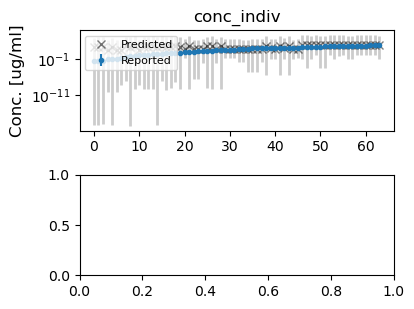

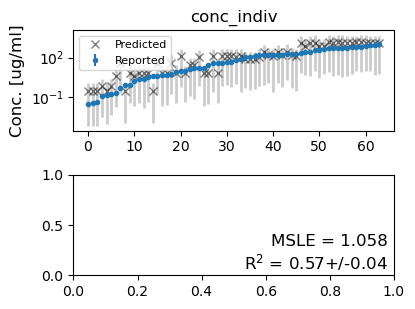

In [60]:
pfas_female_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_female_mouse.plot_data_ppc(group='posterior', savefig=True)

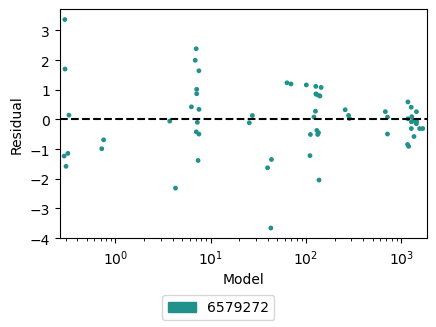

In [61]:
pfas_female_mouse.plot_residuals() 

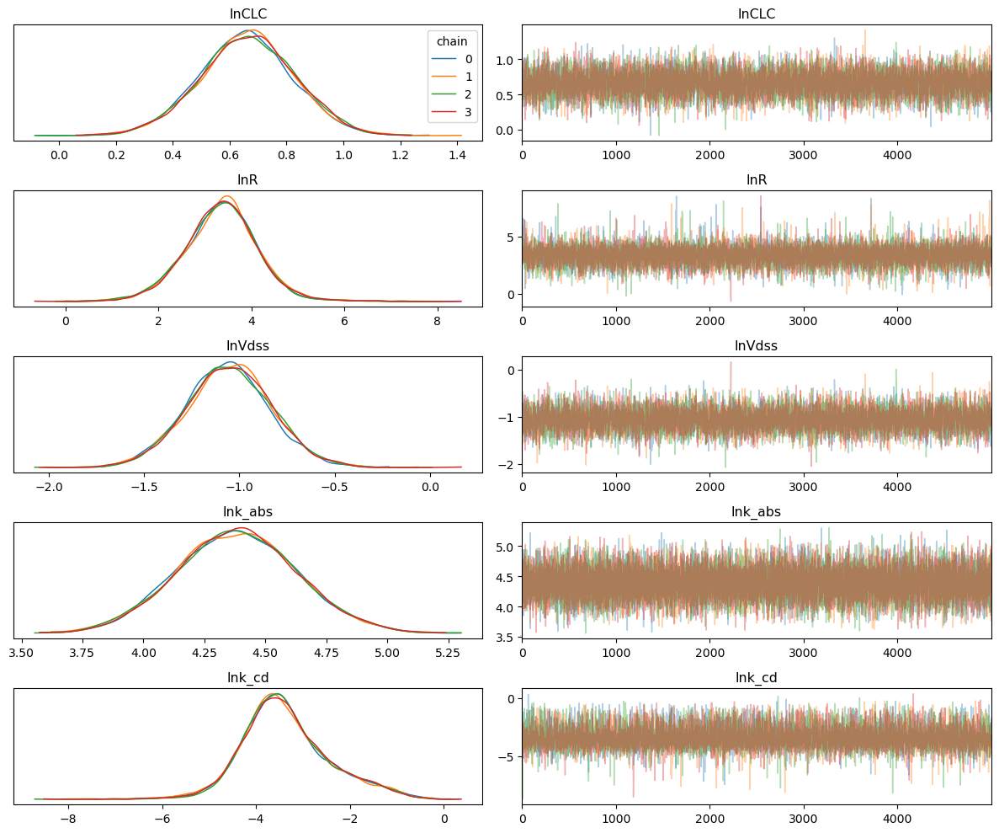

In [62]:
trace_model = pfas_female_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFBS/PFBS_Female_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


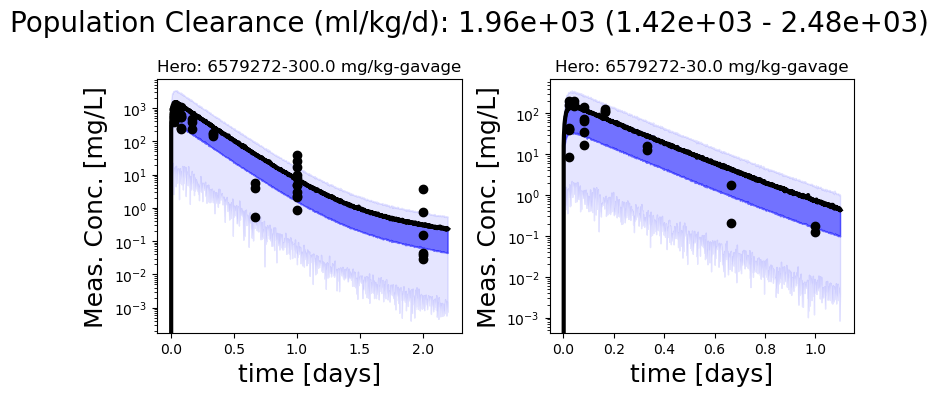

In [63]:
pfas_female_mouse.plot_all_studies()

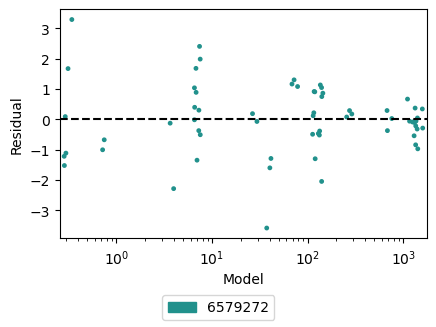

In [64]:
pfas_female_mouse.plot_residuals()

### PK stats

In [65]:
pfas_female_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],1.96293,0.32743,1.42345,2.48274
Vc [pop],0.34043,0.07651,0.21746,0.45950
Vdss [pop],0.35687,0.08164,0.22645,0.48094
abs_halft [pop],0.00890,0.00221,0.00542,0.01243
halft [pop],0.12535,0.01418,0.10417,0.14802
halft_alpha [pop],0.11764,0.01466,0.09607,0.14103
halft_beta [pop],1.12029,5.85951,0.13567,2.12981


# Primate

HERO_ID = 2850396 only reports out to 2 days and a hierarchical model can introduce divergences in sampling. Options are to either remove 2850396 or increase target_accept for smaller step sizes.

## Male

In [66]:
%%time
pfas_male_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='primate')
pfas_male_data_primate.head()

Hero ID available:  [1326734 2850396 5387170 6579272]
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defau

,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1326734,30,12,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,19882.06725,0.0,0,ng/ml,iv,serum,Male,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.083333,10.0,2.6,19.882067,0.0,0.0,-1,0,0,0,0.0,2.989818,0.0,True,26.0,1326734-10.0 mg/kg-iv
1,1326734,30,14,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,36860.69059,0.0,0,ng/ml,iv,serum,Male,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.083333,10.0,2.6,36.860691,0.0,0.0,-1,0,0,0,0.0,3.607146,0.0,True,26.0,1326734-10.0 mg/kg-iv
2,1326734,30,12,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,10.0,mg/kg,4.0,hour,30414.23681,0.0,0,ng/ml,iv,serum,Male,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.166667,10.0,2.6,30.414237,0.0,0.0,-1,0,0,0,0.0,3.414911,0.0,True,26.0,1326734-10.0 mg/kg-iv
3,1326734,30,13,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,10.0,mg/kg,4.0,hour,40491.32265,0.0,0,ng/ml,iv,serum,Male,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.166667,10.0,2.6,40.491323,0.0,0.0,-1,0,0,0,0.0,3.701088,0.0,True,26.0,1326734-10.0 mg/kg-iv
4,1326734,30,14,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,10.0,mg/kg,4.0,hour,30190.90704,0.0,0,ng/ml,iv,serum,Male,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.166667,10.0,2.6,30.190907,0.0,0.0,-1,0,0,0,0.0,3.407541,0.0,True,26.0,1326734-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [67]:
pfas_male_1cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.999, nuts_sampler='numpyro', #hierarchy='single',
                             load_trace=load_trace, tune=10000, draws=1000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Male_primate_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/11000 [00:00<?, ?it/s]

  0%|          | 0/11000 [00:00<?, ?it/s]

  0%|          | 0/11000 [00:00<?, ?it/s]

  0%|          | 0/11000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (39), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


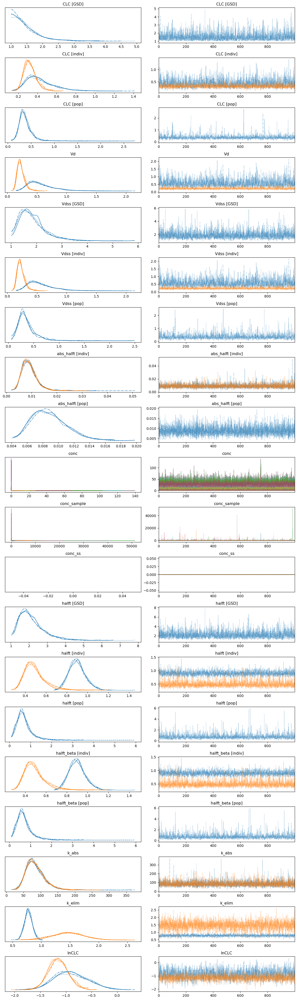

In [68]:
with pfas_male_1cmpt_primate.model:
    az.plot_trace(pfas_male_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


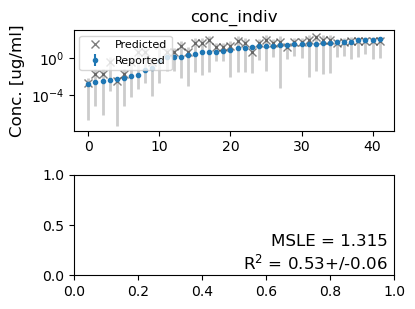

In [69]:
pfas_male_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [70]:
pfas_male_2cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior

                                )
pfas_male_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro', #hierarchy='single',
                             load_trace=load_trace, tune=15000, draws=10000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Male_primate_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/25000 [00:00<?, ?it/s]

  0%|          | 0/25000 [00:00<?, ?it/s]

  0%|          | 0/25000 [00:00<?, ?it/s]

  0%|          | 0/25000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (77), generating only 20 plots
  warnings.warn(


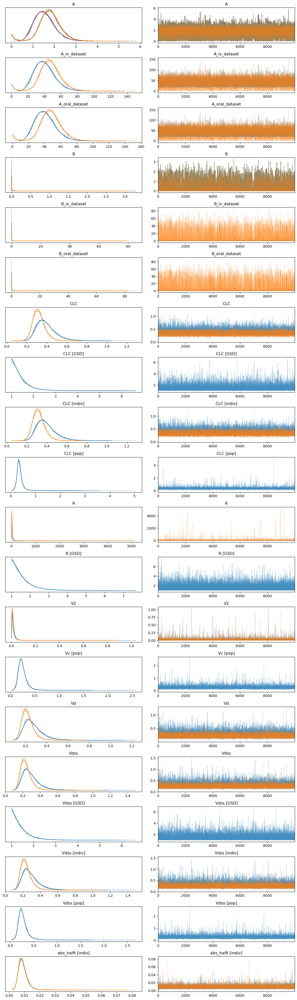

In [71]:
with pfas_male_2cmpt_primate.model:
    az.plot_trace(pfas_male_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


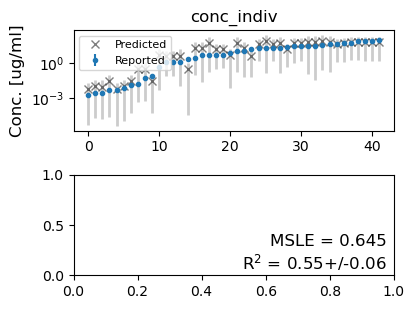

In [72]:
pfas_male_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-100.03337,10.674065,0.00000,0.849808,22.539598,0.000000,True,log
1_compartment,1,-106.55734,7.773223,6.52397,0.150192,20.370544,5.905602,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

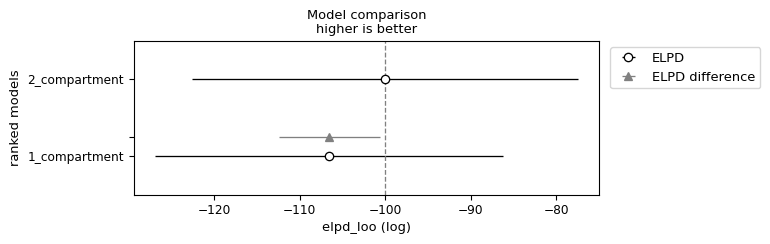

In [73]:
pfas_male_primate_compare = az.compare({"1_compartment": pfas_male_1cmpt_primate._trace, "2_compartment": pfas_male_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_male_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [100]:
pfas_male_primate = pfas_male_2cmpt_primate
print(pfas_male_primate.N_divergences)
print(f'Pass all metrics = {pfas_male_primate.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


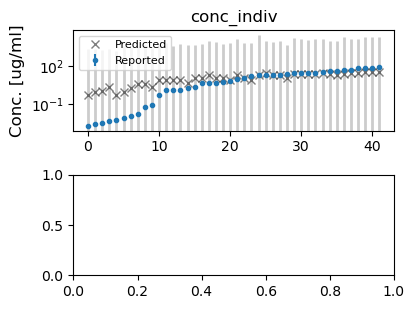

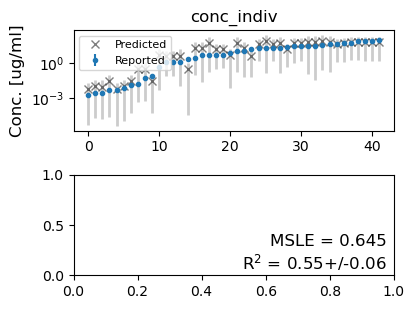

In [75]:
pfas_male_primate.plot_data_ppc(group='prior', savefig=True)
pfas_male_primate.plot_data_ppc(group='posterior', savefig=True)

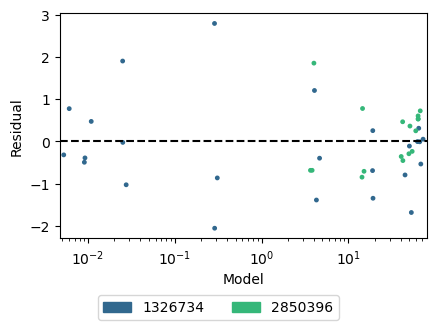

In [76]:
pfas_male_primate.plot_residuals() 

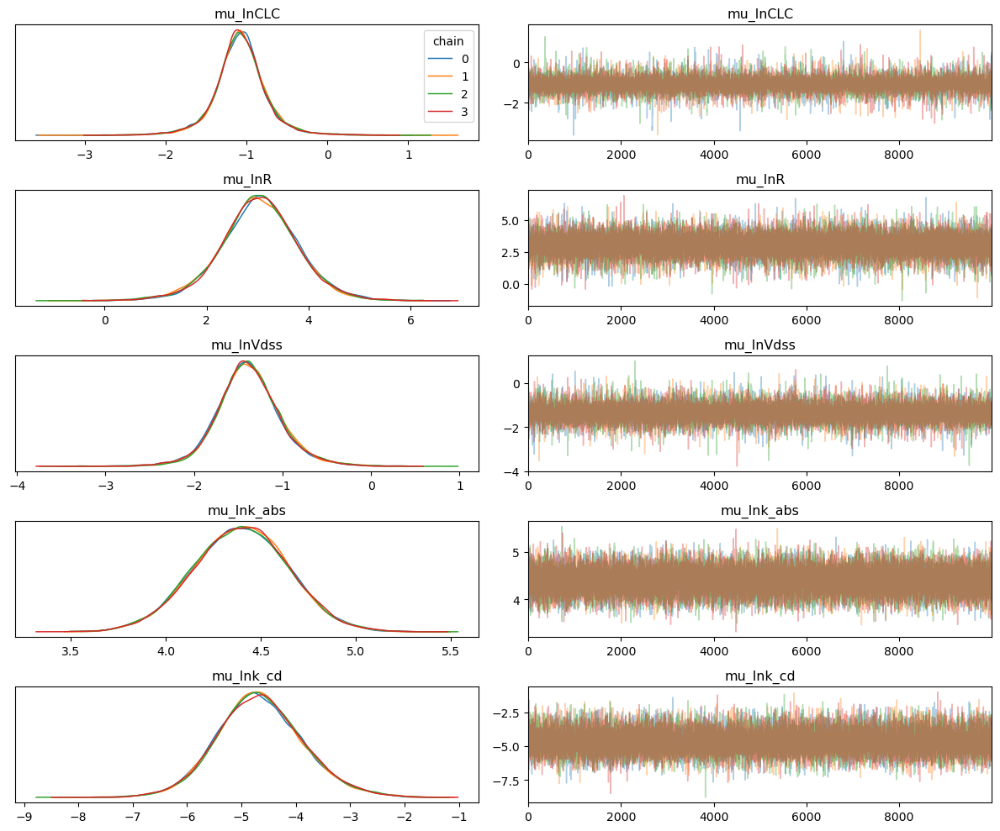

In [77]:
trace_model = pfas_male_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFBS/PFBS_Male_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


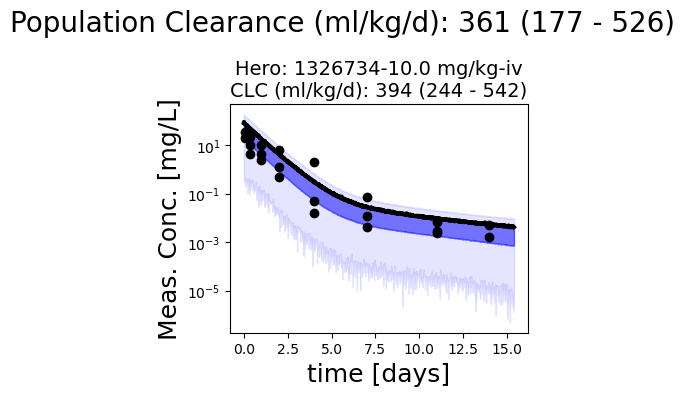

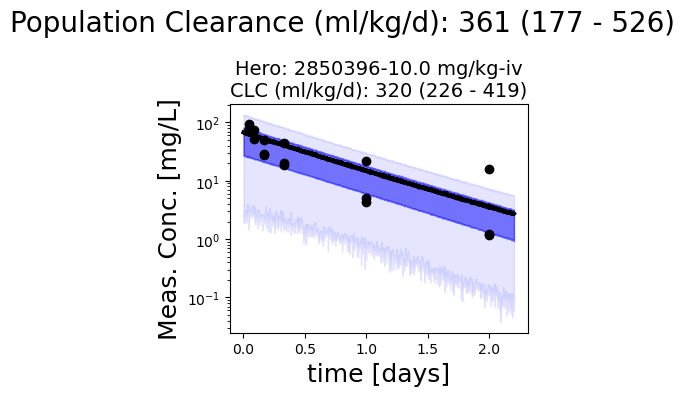

In [78]:
pfas_male_primate.plot_all_studies()

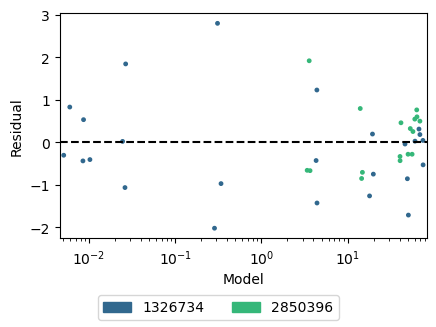

In [79]:
pfas_male_primate.plot_residuals()

### PK stats

In [80]:
pfas_male_primate.get_pk_stats() # Single

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.36100,0.14320,0.17699,0.52559
Vc [pop],0.25327,0.10467,0.11057,0.38375
Vdss [pop],0.26996,0.11336,0.12125,0.41720
abs_halft [pop],0.00881,0.00223,0.00526,0.01222
halft [pop],0.56385,0.30647,0.18751,0.88468
halft_alpha [pop],0.51180,0.24335,0.17822,0.80334
halft_beta [pop],5.39926,8.37777,0.34433,11.10991


## Female

In [81]:
%%time
pfas_female_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='primate')
pfas_female_data_primate.head()

Hero ID available:  [1326734 2850396 5387170 6579272]
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defaults
No BW info for primate in 1326734, using defau

,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1326734,31,15,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,56734.35918,0.0,0,ng/ml,iv,serum,Female,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.083333,10.0,2.5,56.734359,0.0,0.0,-1,0,0,1,0.0,4.038380,0.0,True,25.0,1326734-10.0 mg/kg-iv
1,1326734,31,16,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,60416.42387,0.0,0,ng/ml,iv,serum,Female,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.083333,10.0,2.5,60.416424,0.0,0.0,-1,0,0,1,0.0,4.101261,0.0,True,25.0,1326734-10.0 mg/kg-iv
2,1326734,31,17,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,45335.84531,0.0,0,ng/ml,iv,serum,Female,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.083333,10.0,2.5,45.335845,0.0,0.0,-1,0,0,1,0.0,3.814098,0.0,True,25.0,1326734-10.0 mg/kg-iv
3,1326734,31,15,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,4.0,hour,40378.84072,0.0,0,ng/ml,iv,serum,Female,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.166667,10.0,2.5,40.378841,0.0,0.0,-1,0,0,1,0.0,3.698306,0.0,True,25.0,1326734-10.0 mg/kg-iv
4,1326734,31,16,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,4.0,hour,30005.69203,0.0,0,ng/ml,iv,serum,Female,DTXSID5030030,Figure 4,2.75,years,NaN,Not Reported,1,Olsen,Perfluorobutanesulfonic acid,PFBS,375-73-5,"1,1,2,2,3,3,4,4,4-nonafluorobutane-1-sulfonic ...",DTXSID5030030,7,0,0,0,0.166667,10.0,2.5,30.005692,0.0,0.0,-1,0,0,1,0.0,3.401387,0.0,True,25.0,1326734-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [82]:
pfas_female_1cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.995, nuts_sampler='numpyro', #hierarchy='single',
                             load_trace=load_trace, tune=10000, draws=10000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Female_primate_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (39), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


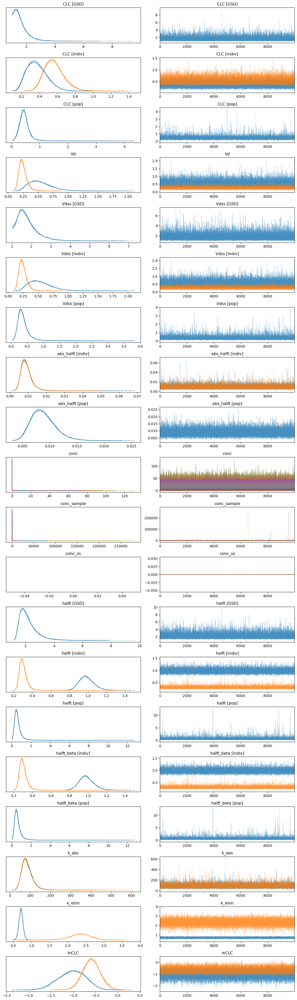

In [83]:
with pfas_female_1cmpt_primate.model:
    az.plot_trace(pfas_female_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


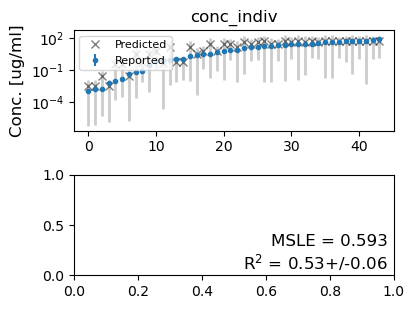

In [84]:
pfas_female_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [85]:
pfas_female_2cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.995, nuts_sampler='numpyro', #hierarchy='single',
                             load_trace=load_trace, tune=10000, draws=10000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFBS_Female_primate_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (77), generating only 20 plots
  warnings.warn(


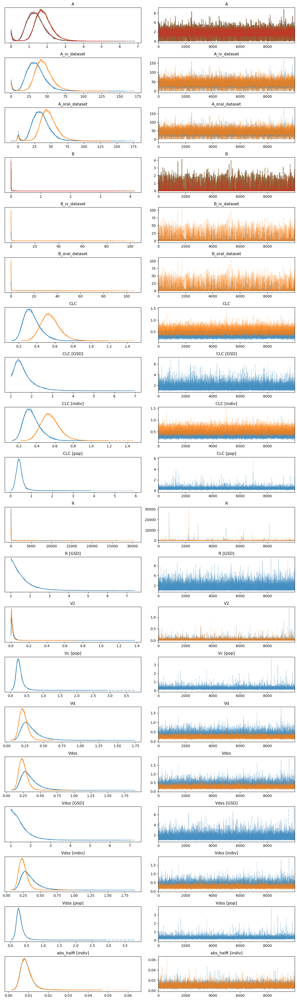

In [86]:
with pfas_female_2cmpt_primate.model:
    az.plot_trace(pfas_female_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


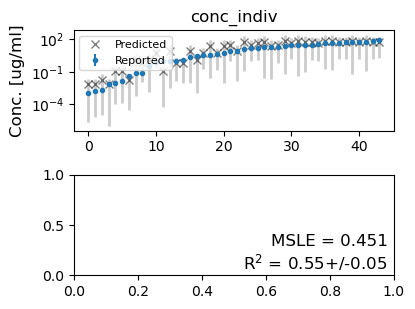

In [87]:
pfas_female_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-112.118504,10.036827,0.000000,0.745546,19.542111,0.000000,True,log
1_compartment,1,-113.583566,6.601910,1.465061,0.254454,18.584803,4.805872,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

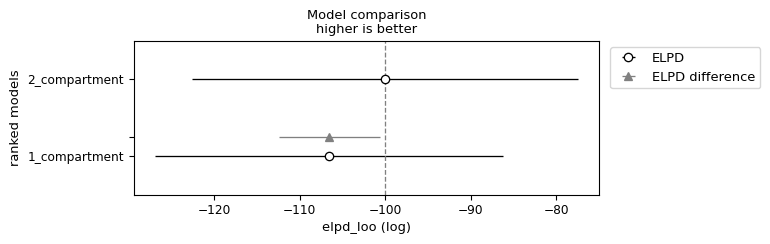

In [88]:
pfas_female_primate_compare = az.compare({"1_compartment": pfas_female_1cmpt_primate._trace, "2_compartment": pfas_female_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_female_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [101]:
pfas_female_primate = pfas_female_2cmpt_primate
print(pfas_female_primate.N_divergences)
print(f'Pass all metrics = {pfas_female_primate.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


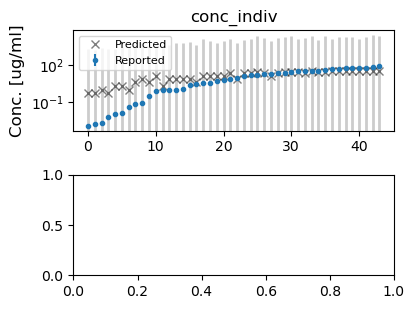

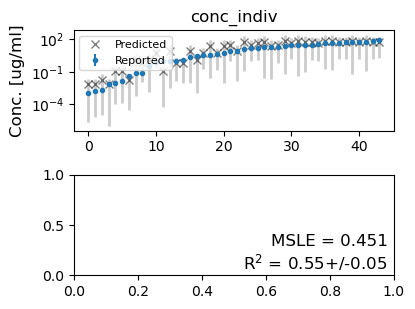

In [90]:
pfas_female_primate.plot_data_ppc(group='prior', savefig=True)
pfas_female_primate.plot_data_ppc(group='posterior', savefig=True)

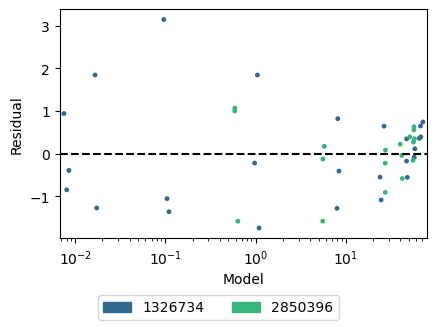

In [91]:
pfas_female_primate.plot_residuals() 

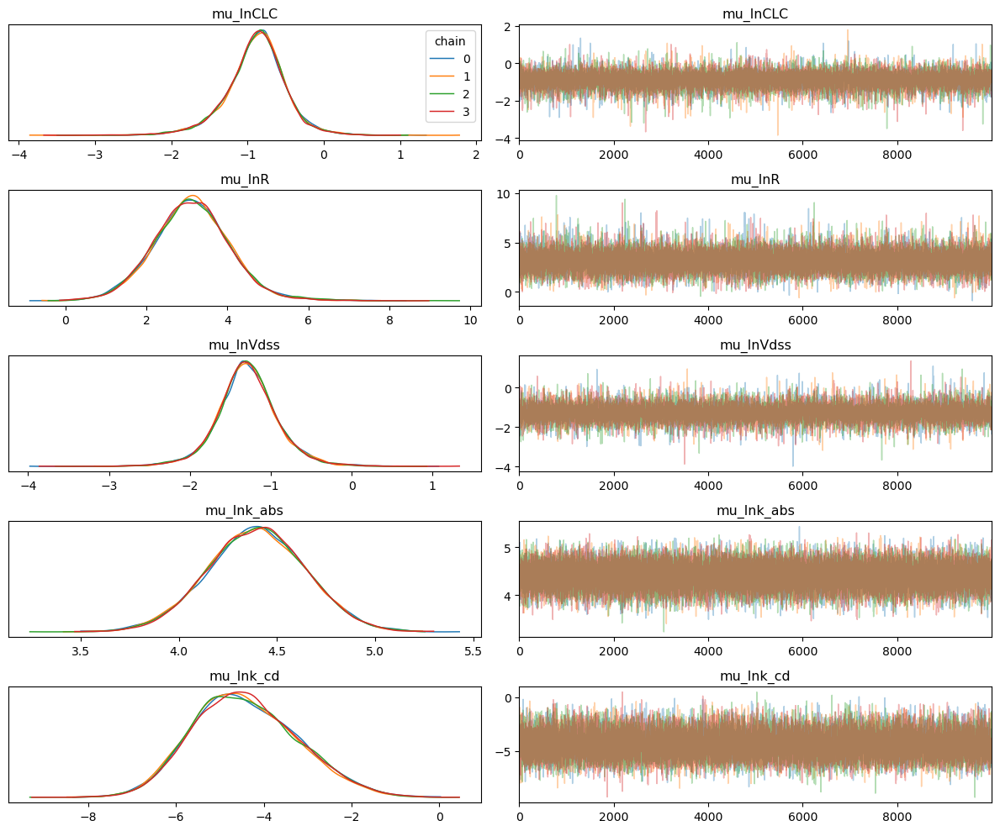

In [92]:
trace_model = pfas_female_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFBS/PFBS_Female_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


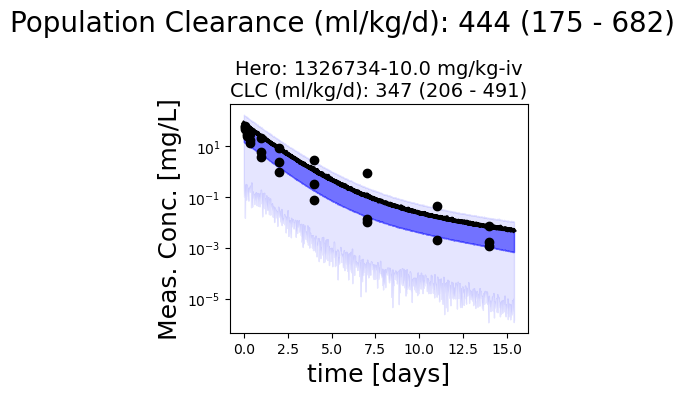

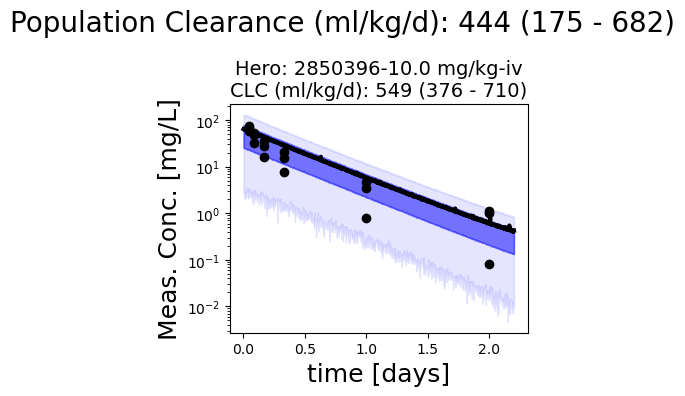

In [93]:
pfas_female_primate.plot_all_studies()

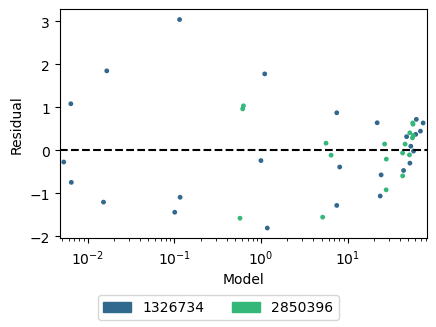

In [94]:
pfas_female_primate.plot_residuals()

### PK stats

In [95]:
pfas_female_primate.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.44368,0.18985,0.17527,0.68163
Vc [pop],0.28000,0.12805,0.10766,0.42939
Vdss [pop],0.29847,0.13564,0.12129,0.46487
abs_halft [pop],0.00882,0.00225,0.00531,0.01230
halft [pop],0.52773,0.32243,0.14399,0.86887
halft_alpha [pop],0.46312,0.25335,0.13245,0.78453
halft_beta [pop],4.66220,11.06502,0.23957,9.52222
